## Importing, Cleaning and Processing

This process is detailed in CA4023-Part-2.ipynb

In [1]:
import pandas as pd
import string

df = pd.read_table('../../data/etymwn.tsv', header=None)

df2 = df.loc[df[0].str[:3] == 'eng']

df3 = df2.loc[df2[1].str[4:] == 'etymology']

df4 = df3.loc[df3[2].str[:3] != 'eng']

df4[2] = df4[2].str[:3]

df4[0] = df4[0].str[4:]

df4 = df4.drop(1, axis=1)

lanAlt = pd.read_csv('../../data/iso-639-3_Name_Index_20230123.tab', sep='\t')

lang_dict = dict(zip(lanAlt['Id'], lanAlt['Print_Name']))
lang_dict['p_s'] = 'unknown'
lang_dict['nah'] = 'Nahuatl'
lang_dict['nan'] = 'Min Nan'
lang_dict['wit'] = 'unknown'

for i, v in df4.iterrows():
    df4[2][i] = lang_dict[v[2]]
    v[0] = v[0].replace('-', '')
    v[0] = v[0].replace("'", "")

df4[2] = df4[2].str.replace(r'\(.*\)', '', regex=True)

language_counts = df4[2].value_counts()
result_df = pd.DataFrame({'Language': language_counts.index, 'Count': language_counts.values})
topLang = result_df['Language'].tolist()[:10]

drop_in = []

for i, v in df4.iterrows():
  if v[2] not in topLang:
    drop_in.append(i)

for i in drop_in:
  df4.drop(i, inplace=True)

lang_data = df4

for i, v in lang_data.iterrows():
  if "English" in v[2]:
    lang_data[2][i] = "English"
  elif "French" in v[2]:
    lang_data[2][i] = "French"

C:\Users\stang\AppData\Local\Temp\ipykernel_4128\1808420969.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4[2] = df4[2].str[:3]
C:\Users\stang\AppData\Local\Temp\ipykernel_4128\1808420969.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df4[0] = df4[0].str[4:]
C:\Users\stang\AppData\Local\Temp\ipykernel_4128\1808420969.py:27: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but w

In [2]:
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import transformers
from transformers import AutoModel, BertTokenizerFast, BertForSequenceClassification

c:\Users\stang\miniconda3\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
lang_data.rename(columns={0:'text', 2:'category'}, inplace=True)

In [4]:
labels = lang_data['category'].unique().tolist()
labels = [s.strip() for s in labels]

In [5]:
NUM_LABELS = len(labels)

id2label={id:label for id, label in enumerate(labels)}

label2id={label:id for id, label in enumerate(labels)}

In [6]:
lang_data['labels']=lang_data.category.map(lambda x:label2id[x.strip()])

<Axes: ylabel='count'>

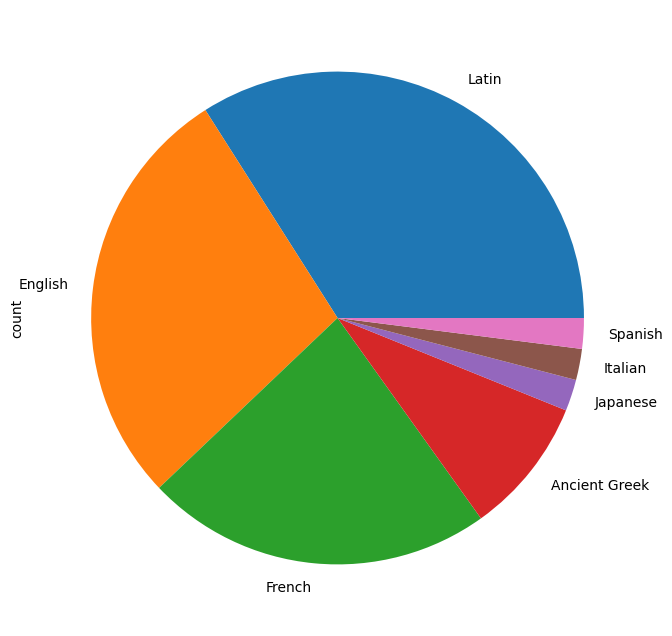

In [7]:
lang_data.category.value_counts().plot(kind='pie', figsize=(8,8))

In [8]:
tokenizer = BertTokenizerFast.from_pretrained('bert-base-uncased', max_length=5)

c:\Users\stang\miniconda3\Lib\site-packages\huggingface_hub\file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


In [9]:
device = torch.device("cuda")

In [10]:
model = BertForSequenceClassification.from_pretrained('bert-base-uncased', num_labels=NUM_LABELS, id2label=id2label, label2id=label2id)
model.to(device)

Some weights of BertForSequenceClassification were not initialized from the model checkpoint at bert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


BertForSequenceClassification(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12,

In [11]:
SIZE=lang_data.shape[0]

train_texts=list(lang_data.text[:SIZE//2])

val_texts=list(lang_data.text[SIZE//2:(3*SIZE)//4])

test_texts=list(lang_data.text[(3*SIZE)//4:])

train_labels=list(lang_data.labels[:SIZE//2])

val_labels=list(lang_data.labels[SIZE//2:(3*SIZE)//4])

test_labels=list(lang_data.labels[(3*SIZE)//4:])

In [12]:
train_encodings = tokenizer(train_texts, truncation=True, padding=True)
val_encodings = tokenizer(val_texts, truncation=True, padding=True)
test_encodings=tokenizer(test_texts, truncation=True, padding=True)

In [13]:
class DataLoader():
  def __init__(self, encodings, labels):
    self.encodings = encodings
    self.labels = labels

  def __getitem__(self, idx):
    item = {key: torch.tensor(val[idx]) for key, val in self.encodings.items()}
    item['labels'] = torch.tensor(self.labels[idx])
    return item

  def __len__(self):
    return len(self.labels)

In [14]:
train_dataloader = DataLoader(train_encodings, train_labels)

val_dataloader = DataLoader(val_encodings, val_labels)

test_dataloader = DataLoader(test_encodings, test_labels)

In [15]:
from transformers import TrainingArguments, Trainer

In [16]:
from sklearn.metrics import accuracy_score, precision_recall_fscore_support

def compute_metrics(pred):
  labels = pred.label_ids

  preds = pred.predictions.argmax(-1)

  precision, recall, f1, _ = precision_recall_fscore_support(labels, preds, average='macro')

  acc = accuracy_score(labels, preds)

  return {
      'Accuracy':acc,
      'F1':f1,
      'Precision':precision,
      'Recall':recall
  }

In [17]:
training_args = TrainingArguments(
    output_dir='../../Assignment',
    do_train=True,
    do_eval=True,
    num_train_epochs=10,
    per_device_train_batch_size=64,
    per_device_eval_batch_size=128,
    warmup_steps=100,
    weight_decay=0.02,
    logging_strategy='steps',
    logging_dir='../../Assignment/logs',
    logging_steps=50,
    evaluation_strategy='steps',
    eval_steps=50,
    save_strategy='steps',
    fp16=True,
    load_best_model_at_end=True
)

In [18]:
trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train_dataloader,
    eval_dataset=val_dataloader,
    compute_metrics=compute_metrics
)

In [19]:
trainer.train()

  3%|▎         | 50/1540 [00:04<02:00, 12.41it/s]

{'loss': 1.6819, 'grad_norm': 3.985595226287842, 'learning_rate': 2.5e-05, 'epoch': 0.32}


c:\Users\stang\miniconda3\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
                                                 
  3%|▎         | 51/1540 [00:05<07:03,  3.51it/s]

{'eval_loss': 1.3080557584762573, 'eval_Accuracy': 0.531345721870533, 'eval_F1': 0.2208606845639506, 'eval_Precision': 0.2420328605351407, 'eval_Recall': 0.23891365796276795, 'eval_runtime': 1.3476, 'eval_samples_per_second': 3633.85, 'eval_steps_per_second': 28.94, 'epoch': 0.32}


  6%|▋         | 100/1540 [00:09<01:52, 12.78it/s]

{'loss': 1.1383, 'grad_norm': 6.056349754333496, 'learning_rate': 5e-05, 'epoch': 0.65}


                                                  
  7%|▋         | 103/1540 [00:11<05:17,  4.52it/s]

{'eval_loss': 1.0011757612228394, 'eval_Accuracy': 0.6214008576679599, 'eval_F1': 0.5984225464684971, 'eval_Precision': 0.645573950781739, 'eval_Recall': 0.6136508737254109, 'eval_runtime': 1.3527, 'eval_samples_per_second': 3620.107, 'eval_steps_per_second': 28.831, 'epoch': 0.65}


 10%|▉         | 150/1540 [00:15<01:47, 12.93it/s]

{'loss': 0.9305, 'grad_norm': 7.549377918243408, 'learning_rate': 4.8263888888888895e-05, 'epoch': 0.97}


                                                  
 10%|▉         | 153/1540 [00:16<05:01,  4.60it/s]

{'eval_loss': 0.9289745688438416, 'eval_Accuracy': 0.6389626301817439, 'eval_F1': 0.628922506153378, 'eval_Precision': 0.659742148276617, 'eval_Recall': 0.6265463143328285, 'eval_runtime': 1.3222, 'eval_samples_per_second': 3703.571, 'eval_steps_per_second': 29.495, 'epoch': 0.97}


 13%|█▎        | 200/1540 [00:20<01:44, 12.86it/s]

{'loss': 0.7691, 'grad_norm': 9.638358116149902, 'learning_rate': 4.652777777777778e-05, 'epoch': 1.3}


                                                  
 13%|█▎        | 201/1540 [00:21<06:13,  3.58it/s]

{'eval_loss': 0.8839980363845825, 'eval_Accuracy': 0.6673473555237901, 'eval_F1': 0.6321807174031823, 'eval_Precision': 0.6819845848284577, 'eval_Recall': 0.6010741466041761, 'eval_runtime': 1.3334, 'eval_samples_per_second': 3672.445, 'eval_steps_per_second': 29.248, 'epoch': 1.3}


 16%|█▌        | 250/1540 [00:25<01:41, 12.75it/s]

{'loss': 0.7481, 'grad_norm': 4.88217306137085, 'learning_rate': 4.4791666666666673e-05, 'epoch': 1.62}


                                                  
 16%|█▋        | 251/1540 [00:26<06:01,  3.56it/s]

{'eval_loss': 0.9470478296279907, 'eval_Accuracy': 0.6326322238104962, 'eval_F1': 0.5976245178345775, 'eval_Precision': 0.6712081219989796, 'eval_Recall': 0.5904672024944053, 'eval_runtime': 1.3306, 'eval_samples_per_second': 3680.252, 'eval_steps_per_second': 29.31, 'epoch': 1.62}


 19%|█▉        | 300/1540 [00:30<01:36, 12.85it/s]

{'loss': 0.7414, 'grad_norm': 13.426065444946289, 'learning_rate': 4.305555555555556e-05, 'epoch': 1.95}


                                                  
 20%|█▉        | 301/1540 [00:32<05:45,  3.58it/s]

{'eval_loss': 0.9052738547325134, 'eval_Accuracy': 0.658362262609761, 'eval_F1': 0.6200868049035951, 'eval_Precision': 0.6589179384039501, 'eval_Recall': 0.5948153438647628, 'eval_runtime': 1.3355, 'eval_samples_per_second': 3666.867, 'eval_steps_per_second': 29.203, 'epoch': 1.95}


 23%|██▎       | 350/1540 [00:35<01:32, 12.89it/s]

{'loss': 0.5484, 'grad_norm': 6.350948810577393, 'learning_rate': 4.1319444444444445e-05, 'epoch': 2.27}


                                                  
 23%|██▎       | 353/1540 [00:37<04:21,  4.54it/s]

{'eval_loss': 0.9700008630752563, 'eval_Accuracy': 0.6559117827241168, 'eval_F1': 0.6300110586781094, 'eval_Precision': 0.6467539714130879, 'eval_Recall': 0.6328402037679359, 'eval_runtime': 1.3412, 'eval_samples_per_second': 3651.187, 'eval_steps_per_second': 29.078, 'epoch': 2.27}


 26%|██▌       | 400/1540 [00:41<01:31, 12.43it/s]

{'loss': 0.4963, 'grad_norm': 6.487504005432129, 'learning_rate': 3.958333333333333e-05, 'epoch': 2.6}


                                                  
 26%|██▌       | 401/1540 [00:42<05:24,  3.51it/s]

{'eval_loss': 0.9627079367637634, 'eval_Accuracy': 0.6624463957525015, 'eval_F1': 0.629438753615937, 'eval_Precision': 0.6784899802058979, 'eval_Recall': 0.6109317971545722, 'eval_runtime': 1.3476, 'eval_samples_per_second': 3633.857, 'eval_steps_per_second': 28.94, 'epoch': 2.6}


 29%|██▉       | 450/1540 [00:46<01:24, 12.92it/s]

{'loss': 0.5102, 'grad_norm': 7.825921535491943, 'learning_rate': 3.7847222222222224e-05, 'epoch': 2.92}


                                                  
 29%|██▉       | 451/1540 [00:47<05:05,  3.57it/s]

{'eval_loss': 0.9819762706756592, 'eval_Accuracy': 0.6802123749234225, 'eval_F1': 0.6506999910394118, 'eval_Precision': 0.6535153130410353, 'eval_Recall': 0.653803273899294, 'eval_runtime': 1.3402, 'eval_samples_per_second': 3653.854, 'eval_steps_per_second': 29.1, 'epoch': 2.92}


 32%|███▏      | 500/1540 [00:51<01:20, 12.85it/s]

{'loss': 0.3562, 'grad_norm': 5.022773742675781, 'learning_rate': 3.6145833333333336e-05, 'epoch': 3.25}


                                                  
 32%|███▏      | 500/1540 [00:53<01:20, 12.85it/s]

{'eval_loss': 1.072852373123169, 'eval_Accuracy': 0.6620379824382275, 'eval_F1': 0.6347548264135855, 'eval_Precision': 0.6691789916367604, 'eval_Recall': 0.6266015871963788, 'eval_runtime': 1.3426, 'eval_samples_per_second': 3647.325, 'eval_steps_per_second': 29.048, 'epoch': 3.25}


 36%|███▌      | 550/1540 [00:57<01:18, 12.64it/s]

{'loss': 0.3125, 'grad_norm': 7.767054557800293, 'learning_rate': 3.440972222222222e-05, 'epoch': 3.57}


                                                  
 36%|███▌      | 551/1540 [00:59<04:38,  3.55it/s]

{'eval_loss': 1.0936474800109863, 'eval_Accuracy': 0.6638758423524607, 'eval_F1': 0.6384893622865745, 'eval_Precision': 0.6771520550747215, 'eval_Recall': 0.6178042400925822, 'eval_runtime': 1.3418, 'eval_samples_per_second': 3649.476, 'eval_steps_per_second': 29.065, 'epoch': 3.57}


 39%|███▉      | 600/1540 [01:03<01:12, 12.92it/s]

{'loss': 0.3447, 'grad_norm': 5.913383483886719, 'learning_rate': 3.2673611111111114e-05, 'epoch': 3.9}


                                                  
 39%|███▉      | 601/1540 [01:04<04:23,  3.56it/s]

{'eval_loss': 1.063603401184082, 'eval_Accuracy': 0.6538697161527466, 'eval_F1': 0.6484358423863038, 'eval_Precision': 0.6920252135512153, 'eval_Recall': 0.6227460544750661, 'eval_runtime': 1.3433, 'eval_samples_per_second': 3645.517, 'eval_steps_per_second': 29.033, 'epoch': 3.9}


 42%|████▏     | 650/1540 [01:08<01:08, 12.93it/s]

{'loss': 0.2257, 'grad_norm': 11.552193641662598, 'learning_rate': 3.09375e-05, 'epoch': 4.22}


                                                  
 42%|████▏     | 651/1540 [01:09<04:10,  3.55it/s]

{'eval_loss': 1.2448936700820923, 'eval_Accuracy': 0.665917908923831, 'eval_F1': 0.6437912829107505, 'eval_Precision': 0.6655735482804952, 'eval_Recall': 0.6305156878410921, 'eval_runtime': 1.3492, 'eval_samples_per_second': 3629.552, 'eval_steps_per_second': 28.906, 'epoch': 4.22}


 45%|████▌     | 700/1540 [01:13<01:05, 12.89it/s]

{'loss': 0.2159, 'grad_norm': 8.501786231994629, 'learning_rate': 2.9201388888888892e-05, 'epoch': 4.55}


                                                  
 46%|████▌     | 701/1540 [01:15<03:55,  3.56it/s]

{'eval_loss': 1.2897752523422241, 'eval_Accuracy': 0.6452930365529916, 'eval_F1': 0.6349514221845131, 'eval_Precision': 0.6602810597817159, 'eval_Recall': 0.6233724951118264, 'eval_runtime': 1.3426, 'eval_samples_per_second': 3647.41, 'eval_steps_per_second': 29.048, 'epoch': 4.55}


 49%|████▊     | 750/1540 [01:18<01:02, 12.72it/s]

{'loss': 0.2122, 'grad_norm': 6.293346881866455, 'learning_rate': 2.746527777777778e-05, 'epoch': 4.87}


                                                  
 49%|████▉     | 753/1540 [01:20<02:54,  4.51it/s]

{'eval_loss': 1.257338047027588, 'eval_Accuracy': 0.6436593832958954, 'eval_F1': 0.626844345601002, 'eval_Precision': 0.6988548128456351, 'eval_Recall': 0.5846293858040921, 'eval_runtime': 1.3506, 'eval_samples_per_second': 3625.834, 'eval_steps_per_second': 28.876, 'epoch': 4.87}


 52%|█████▏    | 800/1540 [01:24<00:57, 12.76it/s]

{'loss': 0.1556, 'grad_norm': 9.712379455566406, 'learning_rate': 2.5729166666666664e-05, 'epoch': 5.19}


                                                  
 52%|█████▏    | 801/1540 [01:25<03:27,  3.56it/s]

{'eval_loss': 1.410826325416565, 'eval_Accuracy': 0.6655094956095569, 'eval_F1': 0.6347862684454701, 'eval_Precision': 0.6899122735833743, 'eval_Recall': 0.5959760980722217, 'eval_runtime': 1.343, 'eval_samples_per_second': 3646.412, 'eval_steps_per_second': 29.04, 'epoch': 5.19}


 55%|█████▌    | 850/1540 [01:29<00:53, 12.97it/s]

{'loss': 0.1425, 'grad_norm': 7.19797945022583, 'learning_rate': 2.3993055555555557e-05, 'epoch': 5.52}


                                                  
 55%|█████▌    | 851/1540 [01:30<03:13,  3.57it/s]

{'eval_loss': 1.3864593505859375, 'eval_Accuracy': 0.6589748825811721, 'eval_F1': 0.640833852624518, 'eval_Precision': 0.6734605742859765, 'eval_Recall': 0.626501150506504, 'eval_runtime': 1.3442, 'eval_samples_per_second': 3643.05, 'eval_steps_per_second': 29.013, 'epoch': 5.52}


 58%|█████▊    | 900/1540 [01:34<00:49, 12.94it/s]

{'loss': 0.1543, 'grad_norm': 10.98145580291748, 'learning_rate': 2.2256944444444443e-05, 'epoch': 5.84}


                                                  
 59%|█████▊    | 901/1540 [01:36<03:00,  3.55it/s]

{'eval_loss': 1.4271855354309082, 'eval_Accuracy': 0.6414131100673882, 'eval_F1': 0.6361089977270816, 'eval_Precision': 0.6964633003500952, 'eval_Recall': 0.6036974998953489, 'eval_runtime': 1.3522, 'eval_samples_per_second': 3621.425, 'eval_steps_per_second': 28.841, 'epoch': 5.84}


 62%|██████▏   | 950/1540 [01:39<00:45, 12.97it/s]

{'loss': 0.1156, 'grad_norm': 10.39074420928955, 'learning_rate': 2.0520833333333335e-05, 'epoch': 6.17}


                                                  
 62%|██████▏   | 953/1540 [01:41<02:10,  4.50it/s]

{'eval_loss': 1.519822597503662, 'eval_Accuracy': 0.6642842556667348, 'eval_F1': 0.6392579470000184, 'eval_Precision': 0.676276977521168, 'eval_Recall': 0.6170148547749295, 'eval_runtime': 1.3568, 'eval_samples_per_second': 3609.132, 'eval_steps_per_second': 28.743, 'epoch': 6.17}


 65%|██████▍   | 1000/1540 [01:45<00:41, 12.93it/s]

{'loss': 0.0828, 'grad_norm': 11.244579315185547, 'learning_rate': 1.8784722222222224e-05, 'epoch': 6.49}


                                                   
 65%|██████▍   | 1000/1540 [01:46<00:41, 12.93it/s]

{'eval_loss': 1.5870333909988403, 'eval_Accuracy': 0.6653052889524198, 'eval_F1': 0.6363483049004675, 'eval_Precision': 0.656889198605932, 'eval_Recall': 0.6223442538260854, 'eval_runtime': 1.3478, 'eval_samples_per_second': 3633.205, 'eval_steps_per_second': 28.935, 'epoch': 6.49}


 68%|██████▊   | 1050/1540 [01:51<00:37, 12.94it/s]

{'loss': 0.1068, 'grad_norm': 1.5968902111053467, 'learning_rate': 1.7048611111111114e-05, 'epoch': 6.82}


                                                   
 68%|██████▊   | 1053/1540 [01:52<01:47,  4.55it/s]

{'eval_loss': 1.5060418844223022, 'eval_Accuracy': 0.6642842556667348, 'eval_F1': 0.645067657660886, 'eval_Precision': 0.6651815145570532, 'eval_Recall': 0.6311183970078892, 'eval_runtime': 1.3482, 'eval_samples_per_second': 3632.117, 'eval_steps_per_second': 28.926, 'epoch': 6.82}


 71%|███████▏  | 1100/1540 [01:56<00:34, 12.88it/s]

{'loss': 0.1013, 'grad_norm': 3.5633597373962402, 'learning_rate': 1.5312500000000003e-05, 'epoch': 7.14}


                                                   
 71%|███████▏  | 1101/1540 [01:58<02:03,  3.55it/s]

{'eval_loss': 1.6058567762374878, 'eval_Accuracy': 0.6475393097814989, 'eval_F1': 0.6272718291152976, 'eval_Precision': 0.6600523230363672, 'eval_Recall': 0.6160039281432749, 'eval_runtime': 1.3533, 'eval_samples_per_second': 3618.658, 'eval_steps_per_second': 28.819, 'epoch': 7.14}


 75%|███████▍  | 1150/1540 [02:01<00:30, 12.94it/s]

{'loss': 0.0697, 'grad_norm': 1.8328697681427002, 'learning_rate': 1.3576388888888889e-05, 'epoch': 7.47}


                                                   
 75%|███████▍  | 1151/1540 [02:03<01:49,  3.55it/s]

{'eval_loss': 1.6277287006378174, 'eval_Accuracy': 0.6646926689810088, 'eval_F1': 0.6401142245125626, 'eval_Precision': 0.6664811042857073, 'eval_Recall': 0.6227591234184465, 'eval_runtime': 1.3502, 'eval_samples_per_second': 3626.873, 'eval_steps_per_second': 28.885, 'epoch': 7.47}


 78%|███████▊  | 1200/1540 [02:07<00:26, 12.69it/s]

{'loss': 0.0788, 'grad_norm': 4.937406539916992, 'learning_rate': 1.1840277777777778e-05, 'epoch': 7.79}


                                                   
 78%|███████▊  | 1201/1540 [02:08<01:35,  3.53it/s]

{'eval_loss': 1.6370574235916138, 'eval_Accuracy': 0.6481519297529099, 'eval_F1': 0.6346649302656007, 'eval_Precision': 0.6526127303786696, 'eval_Recall': 0.6245090500322122, 'eval_runtime': 1.3492, 'eval_samples_per_second': 3629.482, 'eval_steps_per_second': 28.905, 'epoch': 7.79}


 81%|████████  | 1250/1540 [02:12<00:22, 13.01it/s]

{'loss': 0.069, 'grad_norm': 5.3358612060546875, 'learning_rate': 1.0104166666666667e-05, 'epoch': 8.12}


                                                   
 81%|████████  | 1251/1540 [02:13<01:21,  3.53it/s]

{'eval_loss': 1.6330777406692505, 'eval_Accuracy': 0.6687768021237492, 'eval_F1': 0.637219638601248, 'eval_Precision': 0.6467945061004807, 'eval_Recall': 0.62858311102653, 'eval_runtime': 1.3542, 'eval_samples_per_second': 3616.028, 'eval_steps_per_second': 28.798, 'epoch': 8.12}


 84%|████████▍ | 1300/1540 [02:17<00:18, 12.91it/s]

{'loss': 0.0539, 'grad_norm': 2.5013513565063477, 'learning_rate': 8.368055555555555e-06, 'epoch': 8.44}


                                                   
 84%|████████▍ | 1301/1540 [02:19<01:07,  3.53it/s]

{'eval_loss': 1.709542155265808, 'eval_Accuracy': 0.6636716356953236, 'eval_F1': 0.6307529846119853, 'eval_Precision': 0.6477009275350573, 'eval_Recall': 0.6203685012389245, 'eval_runtime': 1.3523, 'eval_samples_per_second': 3621.299, 'eval_steps_per_second': 28.84, 'epoch': 8.44}


 88%|████████▊ | 1350/1540 [02:22<00:14, 12.80it/s]

{'loss': 0.0612, 'grad_norm': 4.693558216094971, 'learning_rate': 6.631944444444445e-06, 'epoch': 8.77}


                                                   
 88%|████████▊ | 1351/1540 [02:24<00:53,  3.53it/s]

{'eval_loss': 1.7306568622589111, 'eval_Accuracy': 0.6695936287522973, 'eval_F1': 0.6382673829476239, 'eval_Precision': 0.6659369812001389, 'eval_Recall': 0.6204687213875688, 'eval_runtime': 1.3576, 'eval_samples_per_second': 3607.105, 'eval_steps_per_second': 28.727, 'epoch': 8.77}


 91%|█████████ | 1400/1540 [02:28<00:10, 13.01it/s]

{'loss': 0.0717, 'grad_norm': 2.5604732036590576, 'learning_rate': 4.930555555555556e-06, 'epoch': 9.09}


                                                   
 91%|█████████ | 1401/1540 [02:29<00:39,  3.55it/s]

{'eval_loss': 1.7757830619812012, 'eval_Accuracy': 0.6579538492954871, 'eval_F1': 0.63965847126741, 'eval_Precision': 0.6665292813820481, 'eval_Recall': 0.6223507957412339, 'eval_runtime': 1.3502, 'eval_samples_per_second': 3626.817, 'eval_steps_per_second': 28.884, 'epoch': 9.09}


 94%|█████████▍| 1450/1540 [02:33<00:07, 12.80it/s]

{'loss': 0.0456, 'grad_norm': 2.9203693866729736, 'learning_rate': 3.1944444444444443e-06, 'epoch': 9.42}


                                                   
 94%|█████████▍| 1451/1540 [02:34<00:25,  3.54it/s]

{'eval_loss': 1.761188268661499, 'eval_Accuracy': 0.6691852154380232, 'eval_F1': 0.6443642427386725, 'eval_Precision': 0.6679484607911025, 'eval_Recall': 0.6275487168815309, 'eval_runtime': 1.3542, 'eval_samples_per_second': 3616.041, 'eval_steps_per_second': 28.798, 'epoch': 9.42}


 97%|█████████▋| 1500/1540 [02:38<00:03, 12.60it/s]

{'loss': 0.0396, 'grad_norm': 4.410236358642578, 'learning_rate': 1.4583333333333335e-06, 'epoch': 9.74}


                                                   
 97%|█████████▋| 1500/1540 [02:40<00:03, 12.60it/s]

{'eval_loss': 1.7972899675369263, 'eval_Accuracy': 0.666326322238105, 'eval_F1': 0.6446613753685595, 'eval_Precision': 0.6681474570263434, 'eval_Recall': 0.6290333796640547, 'eval_runtime': 1.3574, 'eval_samples_per_second': 3607.587, 'eval_steps_per_second': 28.731, 'epoch': 9.74}


100%|██████████| 1540/1540 [02:44<00:00,  9.37it/s]

{'train_runtime': 164.3612, 'train_samples_per_second': 595.944, 'train_steps_per_second': 9.37, 'train_loss': 0.3445157368461807, 'epoch': 10.0}


TrainOutput(global_step=1540, training_loss=0.3445157368461807, metrics={'train_runtime': 164.3612, 'train_samples_per_second': 595.944, 'train_steps_per_second': 9.37, 'total_flos': 453038991367500.0, 'train_loss': 0.3445157368461807, 'epoch': 10.0})

In [20]:
q=[trainer.evaluate(eval_dataset=lang_data) for lang_data in [train_dataloader, val_dataloader, test_dataloader]]

pd.DataFrame(q, index=['train', 'val', 'test']).iloc[:,:5]

100%|██████████| 39/39 [00:00<00:00, 45.42it/s]


,eval_loss,eval_Accuracy,eval_F1,eval_Precision,eval_Recall
train,0.217836,0.932925,0.921136,0.923822,0.919750
val,1.072852,0.662038,0.634755,0.669179,0.626602
test,0.943491,0.698040,0.643016,0.667577,0.641922


In [21]:
def predict(text):
  inputs = tokenizer(text, padding=True, truncation=True, max_length=512, return_tensors='pt').to('cuda')

  outputs = model(**inputs)

  probs = outputs[0].softmax(1)
  pred_label_idx = probs.argmax()

  pred_label = model.config.id2label[pred_label_idx.item()]

  return probs, pred_label_idx, pred_label

In [22]:
predict("hello")

(tensor([[0.0025, 0.9733, 0.0155, 0.0037, 0.0011, 0.0024, 0.0016]],
        device='cuda:0', grad_fn=<SoftmaxBackward0>),
 tensor(1, device='cuda:0'),
 'English')